<a href="https://colab.research.google.com/github/tinayiluo0322/XAI_Projects/blob/main/Explainable_Deep_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AIPI 590 - XAI | Assignment #07
### Explainable Deep Learning
### Luopeiwen Yi

# **Introduction**

In recent years, deep learning models have demonstrated impressive performance in medical image classification tasks, providing significant benefits for early diagnosis and treatment decisions. However, their "black-box" nature often leaves healthcare professionals without clear insight into how these models make decisions, raising concerns about trust, safety, and interpretability. The purpose of this experiment is to explore the application of Explainable AI (XAI) techniques, specifically Gradient-weighted Class Activation Mapping (Grad-CAM), to uncover which regions of medical images are most influential in model predictions. By using Grad-CAM, we aim to provide visual explanations that can help bridge the gap between machine intelligence and human interpretability.

The dataset used in this experiment, titled [**Labeled Optical Coherence Tomography (OCT) and Chest X-Ray Images for Classification**](https://data.mendeley.com/datasets/rscbjbr9sj/2) , contains labeled chest X-ray images for binary classification between healthy and pneumonia-affected individuals. The ability to detect pneumonia accurately from chest X-rays is crucial in clinical settings, especially for early detection and timely intervention.

The pre-trained **ResNet50** model after transfer learning will be utilized to classify these images, and Grad-CAM will be employed to generate heatmaps that highlight the regions within the X-rays most relevant to the model’s classification decision. The experiment will focus on comparing the feature importance scores between healthy and pneumonia images to determine whether there is a significant difference in the regions highlighted by the model for each class.

The impact of this experiment lies in its potential to improve the interpretability of deep learning models used in medical image analysis. By identifying which areas of the image are most relevant to the model’s predictions, healthcare professionals can gain a deeper understanding of model decisions, increasing trust and enabling more informed clinical decision-making. Additionally, this approach may help identify any biases in model attention, ensuring that the models are focusing on clinically relevant features, such as lung regions, rather than irrelevant areas.

This experiment aims to combine the power of deep learning with transparency, ultimately contributing to the safe and reliable adoption of AI systems in healthcare.


# **Experiment Design**

## 1. Hypothesis:
- **Null Hypothesis (H0):** There is no significant difference in the feature importance highlighted by Grad-CAM between pneumonia and healthy chest X-ray images when using a pre-trained ResNet50 model.
- **Alternative Hypothesis (H1):** There is a significant difference in the feature importance highlighted by Grad-CAM between pneumonia and healthy chest X-ray images when using a pre-trained ResNet50 model.

---

## 2. Dataset:
- **Name:** Chest X-ray Images (Pneumonia)
- **Classes:**
  - **Pneumonia:** Images labeled as pneumonia.
  - **Healthy:** Images labeled as normal (healthy).
- **Sample Size:**
  - Use **30 images per class** for a balanced comparison.
- **Preprocessing:** Resize images to a consistent size (e.g., 224x224) and normalize pixel values as required by ResNet50.

---

## 3. Model:
- **Model Used:** Pre-trained ResNet50 from the ImageNet dataset.
  - Use the pre-trained version of ResNet50, leveraging transfer learning for pneumonia and healthy classification.
  
---

## 4. XAI Method:
- **Method:** Grad-CAM (Gradient-weighted Class Activation Mapping)
  - Grad-CAM will be used to generate heatmaps that highlight important regions in the chest X-rays that contribute to the classification decision (pneumonia vs. healthy).
  - The heatmaps will provide visual explanations of which regions in the images influence the model's predictions.

---

## 5. Experiment:

### a. Data Preparation:
- Load the Chest X-ray Images (Pneumonia) dataset.
- Randomly select **30 images** from each class (pneumonia and healthy).
- Resize the images to **224x224** and normalize according to ResNet50's input requirements.

### b. Model Inference & Grad-CAM Heatmap Generation:
- Pass each image through the pre-trained ResNet50 model to get predictions for pneumonia and healthy images.
- Use **Grad-CAM** to generate class-specific heatmaps for both pneumonia and healthy images.
- **Store the heatmaps** for both classes.

### c. Feature Importance Aggregation:
- For each image, **average the Grad-CAM heatmap values** across the entire image to create an overall feature importance score.
- This score will represent the importance of image regions for the model’s decision.

### d. Collect Data for Each Class:
- Collect the **aggregated feature importance scores** for each image in the pneumonia class.
- Collect the **aggregated feature importance scores** for each image in the healthy class.

---

## 6. Statistical Testing:

### a. Objective:
- Compare the aggregated feature importance scores between the two classes (pneumonia and healthy) to see if there’s a significant difference in how the model highlights important regions for each class.

### b. Statistical Test:
- Use a **t-test** to compare the means of the feature importance scores for the two groups (pneumonia vs. healthy).
- The t-test will help determine whether the difference in feature importance between the two classes is statistically significant.

### c. Threshold for Significance:
- Set a significance level (e.g., **p < 0.05**). If the p-value is below this threshold, reject the null hypothesis, indicating that there is a significant difference in feature importance between the two classes.

---

## 7. Visualization & Reporting:

- **Grad-CAM Heatmaps**: Visualize a few examples of the Grad-CAM heatmaps for both pneumonia and healthy images to show how the model focuses on different regions.
- **Feature Importance Scores**: Create a plot comparing the feature importance scores between the two classes.
- **Statistical Test Results**: Present the results of the statistical test, including the t-statistic and p-value.


# **Final Conclusion Report**

#### 1. **Analysis of Model Performance (Tailored to ResNet50 Transfer Learning)**:
The first stage of this experiment evaluated the performance of a transfer learning-based model using **ResNet50**, which was pre-trained on ImageNet, to classify chest X-ray images into two categories: **Normal** and **Pneumonia**. The model was adapted for this medical task by freezing the base (convolutional) layers and fine-tuning only the top layers for binary classification.

- **Model Performance**:
  - **Test Accuracy**: The model achieved an accuracy of **77.40%**, which reflects reasonable performance for this task.
  - **Class-wise Performance**: The model performed significantly better on the **Pneumonia** class, with a recall of **0.68** and an F1-score of **0.65**. However, it struggled to correctly classify **Normal** cases, with a recall of only **0.29**.
  
- **Challenges with Normal Class**: The model showed **poor performance** in detecting normal lungs, misclassifying a significant number of healthy images as pneumonia. This discrepancy could be attributed to the class imbalance in the dataset (390 Pneumonia cases vs. 234 Normal cases), as well as the domain gap between ImageNet images and medical X-rays.

- **Transfer Learning Insights**: While the **ResNet50 model** was effective in identifying pneumonia features, it demonstrated limitations in detecting healthy lung features, which suggests that further fine-tuning or additional training may be required to improve its overall generalization, particularly for normal cases.

#### 2. **Analysis of Grad-CAM Visualization Results**:
The second phase of the experiment involved using **Grad-CAM** to visualize the regions of the X-ray images that were most influential in the model’s decision-making process. This method provided insight into which areas the model focused on when classifying **Pneumonia** and **Normal** images.

- **Key Findings**:
  - **Focus on the Diaphragm**: Both healthy and pneumonia cases showed **strong attention on the diaphragm** (red area), which is not typically a key region for diagnosing lung conditions like pneumonia. This suggests that the model may be misinterpreting important features.
  - **Attention on the Right Blank Area**: Another surprising finding was the model’s focus on the **blank area outside the body** (yellow area), which holds no diagnostic value. This could be a result of overfitting to irrelevant patterns or artifacts in the dataset.
  - **Less Focus on the Lung Area**: The **lungs** (blue area) received less attention from the model, indicating that the model is not effectively identifying the critical lung regions needed for accurate diagnosis.

- **Transfer Learning Implications**: The reason for this misfocus may lie in the fact that the convolutional layers were **frozen** during transfer learning. As a result, the **pre-trained ResNet50 model** could not correctly adapt its feature extraction to focus on the relevant regions in medical X-ray images. This highlights the need for further fine-tuning of the base layers to better capture medically relevant features, especially in the lung regions.

#### 3. **Interpretation of the Statistical Analysis**:
The third phase of the experiment focused on statistically analyzing the **feature importance scores** generated by Grad-CAM for **Pneumonia** and **Normal** images. The goal was to determine whether there was a significant difference in how the model highlighted important regions between the two classes.

- **Summary Statistics**:
  - The **mean feature importance score** for Pneumonia images was **0.242**, slightly higher than the score for Normal images, which was **0.215**.
  - The **t-test** results showed a **t-statistic of -5.3253** and a **p-value of 0.0000**, which is far below the significance threshold (p < 0.05).

- **Hypothesis Testing**:
  - **Null Hypothesis (H₀)**: There is no significant difference in the feature importance highlighted by Grad-CAM between pneumonia and healthy chest X-ray images when using a pre-trained ResNet50 model.
  - **Alternative Hypothesis (H₁)**: There is a significant difference in the feature importance highlighted by Grad-CAM between pneumonia and healthy chest X-ray images when using a pre-trained ResNet50 model.
  
  Since the **p-value** was significantly lower than the threshold, we **rejected the null hypothesis**, indicating that there is a statistically significant difference in how the pre-trained ResNet50 model highlights important regions for Pneumonia vs. Normal images.

- **Effect Size (Cohen's d)**: The calculated **Cohen's d** was **1.3985**, which indicates a **large effect size**. This suggests that the difference in feature importance between the two classes is not only statistically significant but also substantial in magnitude.

- **Conclusion**: The model clearly behaves differently when interpreting healthy and pneumonia images, with pneumonia images receiving higher feature importance scores. This shows that the pre-trained ResNet50 model is better at focusing on pneumonia-related features, although its attention to healthy lung features remains problematic.

---

### Final Conclusion

This experiment has successfully demonstrated that using a **pre-trained ResNet50 model** for pneumonia detection on chest X-ray images, combined with **Grad-CAM visualization**, provides insights into the model’s decision-making process. However, the experiment also reveals several areas that require improvement:

- **Model Performance**: While the model performs well on Pneumonia cases, achieving a recall of **0.68**, its performance on Normal cases is significantly worse, with a recall of **0.29**. This suggests that the model is biased toward detecting pneumonia and struggles with healthy lungs.
  
- **Grad-CAM Visualizations**: The **Grad-CAM** heatmaps revealed that the model's attention is often focused on irrelevant areas (e.g., the diaphragm and blank regions) rather than the lungs themselves. This misfocus is likely due to freezing the convolutional layers during transfer learning, preventing the model from adapting to the specific task of pneumonia detection.

- **Statistical Significance**: The statistical analysis of the feature importance scores confirmed that there is a **significant difference** in how the model interprets pneumonia vs. healthy images, with the model assigning more importance to regions in pneumonia images. The large effect size (Cohen's d = 1.3985) further supports the practical relevance of this finding.

- **Recommendations**:
  - **Unfreeze and Fine-Tune**: To improve the model’s focus on relevant lung areas, unfreezing the convolutional layers during transfer learning is recommended, allowing the model to better adapt to medical imaging features.
  - **Class Balancing**: Address the class imbalance in the dataset to reduce the model's bias toward pneumonia.
  - **Further Validation**: Additional experiments with a larger and more balanced dataset will be crucial for improving the model’s generalization capabilities across both classes.

This experiment has highlighted the potential of combining deep learning and **Explainable AI (XAI)** techniques like Grad-CAM to enhance the transparency and reliability of AI systems in healthcare. However, further refinements are necessary to optimize the model for real-world clinical applications, particularly in detecting healthy lungs with greater accuracy.



In [ ]:
import os

# Remove Colab default sample_data if it exists
if os.path.isdir("./sample_data"):
    !rm -r ./sample_data

# Clone GitHub repo (force re-clone if it already exists)
repo_name = "XAI_Projects"
git_path = 'https://github.com/tinayiluo0322/XAI_Projects.git'

if os.path.isdir(repo_name):
    !rm -rf "{repo_name}"
!git clone "{git_path}"

# Install dependencies from requirements.txt if it exists
#requirements_file = os.path.join(repo_name, 'requirements.txt')
#if os.path.isfile(requirements_file):
    #!pip install -r "{requirements_file}"
#else:
    #print("No requirements.txt found, skipping dependency installation.")

# Change working directory to location of notebook
notebook_dir = 'Explainable Deep Learning'
path_to_notebook = os.path.join(repo_name, notebook_dir)

# Check if the directory exists
if os.path.isdir(path_to_notebook):
    %cd "{path_to_notebook}"
    %ls
else:
    print(f"Directory {path_to_notebook} not found")

Cloning into 'XAI_Projects'...
remote: Enumerating objects: 6132, done.
remote: Counting objects: 100% (54/54), done.
remote: Compressing objects: 100% (47/47), done.
remote: Total 6132 (delta 24), reused 6 (delta 6), pack-reused 6078 (from 1)
Receiving objects: 100% (6132/6132), 113.55 MiB | 16.43 MiB/s, done.
Resolving deltas: 100% (47/47), done.
/content/XAI_Projects/Explainable Deep Learning
placeholder


In [36]:
!pip install tf-nightly
from google.colab import drive
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.metrics import classification_report, roc_auc_score, roc_curve
import seaborn as sns
import random
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.metrics import confusion_matrix
import os
import cv2
from scipy import stats

In [ ]:
# Check if TensorFlow is using a GPU
print("Is TensorFlow using a GPU? ", tf.config.list_physical_devices('GPU'))

# List all available GPUs
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"Number of available GPUs: {len(gpus)}")
    for gpu in gpus:
        print("GPU:", gpu)
else:
    print("No GPU available. TensorFlow will use CPU instead.")

Is TensorFlow using a GPU?  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Number of available GPUs: 1
GPU: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [ ]:
# Enable memory growth for the GPU
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

In [ ]:
# Set random seeds for reproducibility
seed = 42
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

In [ ]:
# Ensure TensorFlow runs deterministically on GPU
os.environ['TF_DETERMINISTIC_OPS'] = '1'

In [ ]:
# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


### Data Preperation

In [ ]:
# Define paths to the data
train_dir = '/content/drive/My Drive/chest_xray/train'
test_dir = '/content/drive/My Drive/chest_xray/test'

# Preprocessing - Resize images and normalize pixel values
img_size = 224  # ResNet50 input size
batch_size = 32

# Create ImageDataGenerators for training and testing data
train_datagen = ImageDataGenerator(
    rescale=1./255,  # Normalize pixel values to [0,1]
    shear_range=0.2,  # Augmentation for train data
    zoom_range=0.2,
    horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1./255)  # Only rescale for test data, no augmentation

# Flow images from directories for training and testing
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_size, img_size),
    batch_size=batch_size,
    class_mode='binary')  # Binary classification (NORMAL, PNEUMONIA)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_size, img_size),
    batch_size=batch_size,
    class_mode='binary')

Found 5242 images belonging to 2 classes.
Found 624 images belonging to 2 classes.


In [ ]:
# Print the classes to verify the import
print(train_generator.class_indices)
print(test_generator.class_indices)

{'NORMAL': 0, 'PNEUMONIA': 1}
{'NORMAL': 0, 'PNEUMONIA': 1}


### Exploratory Data Analysis

Training set - NORMAL: 1349, PNEUMONIA: 3893
Test set - NORMAL: 234, PNEUMONIA: 390


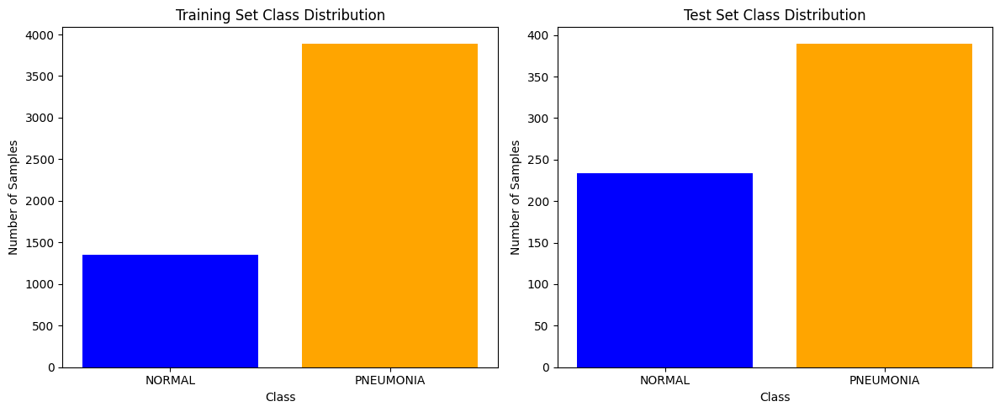

In [ ]:
# Get class indices
class_labels = train_generator.class_indices  # {'NORMAL': 0, 'PNEUMONIA': 1}
class_names = list(class_labels.keys())  # ['NORMAL', 'PNEUMONIA']

# Get the number of samples in the training set
train_counts = [train_generator.labels.tolist().count(i) for i in range(len(class_labels))]
test_counts = [test_generator.labels.tolist().count(i) for i in range(len(class_labels))]

# Print the counts
print(f"Training set - NORMAL: {train_counts[0]}, PNEUMONIA: {train_counts[1]}")
print(f"Test set - NORMAL: {test_counts[0]}, PNEUMONIA: {test_counts[1]}")

# Plot class distribution for train and test sets
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

# Plot for the training set
axs[0].bar(class_names, train_counts, color=['blue', 'orange'])
axs[0].set_title('Training Set Class Distribution')
axs[0].set_xlabel('Class')
axs[0].set_ylabel('Number of Samples')

# Plot for the test set
axs[1].bar(class_names, test_counts, color=['blue', 'orange'])
axs[1].set_title('Test Set Class Distribution')
axs[1].set_xlabel('Class')
axs[1].set_ylabel('Number of Samples')

plt.tight_layout()
plt.show()

### Transfer Learning with ResNet50

In [ ]:
# Load pre-trained ResNet50 model, excluding the top layer
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the base model layers so they won’t be retrained
for layer in base_model.layers:
    layer.trainable = False

# Add custom layers for binary classification
x = base_model.output
x = GlobalAveragePooling2D()(x)  # Global pooling reduces feature map size
x = Dense(1024, activation='relu')(x)  # Add a fully connected layer
x = Dense(1, activation='sigmoid')(x)  # Final layer for binary classification (output: pneumonia/healthy)

# Create the final model
model = Model(inputs=base_model.input, outputs=x)

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# Print the model summary to confirm the structure
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 25,686,913 (97.99 MB)

 Trainable params: 2,099,201 (8.01 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [ ]:
# Add EarlyStopping to stop training if validation accuracy doesn't improve for 5 epochs
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True)

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=test_generator,
    validation_steps=test_generator.samples // batch_size,
    callbacks=[early_stopping]
)

Epoch 1/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 248s 2s/step - accuracy: 0.7491 - loss: 0.4865 - val_accuracy: 0.6645 - val_loss: 0.5562
Epoch 2/10
  1/163 ━━━━━━━━━━━━━━━━━━━━ 1:39 617ms/step - accuracy: 0.8438 - loss: 0.3586

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8438 - loss: 0.3586 - val_accuracy: 0.4375 - val_loss: 0.7902
Epoch 3/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 122s 748ms/step - accuracy: 0.7643 - loss: 0.4695 - val_accuracy: 0.6595 - val_loss: 0.5652
Epoch 4/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8438 - loss: 0.3710 - val_accuracy: 0.6875 - val_loss: 0.4780
Epoch 5/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 115s 707ms/step - accuracy: 0.7837 - loss: 0.4271 - val_accuracy: 0.6908 - val_loss: 0.5418
Epoch 6/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8438 - loss: 0.3128 - val_accuracy: 0.7500 - val_loss: 0.4613
Epoch 7/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 115s 707ms/step - accuracy: 0.7821 - loss: 0.4279 - val_accuracy: 0.7763 - val_loss: 0.4903
Epoch 8/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7188 - loss: 0.5292 - val_accuracy: 0.7500 - val_loss: 0.5365
Epoch 9/10
163/163 ━━━━━━━━━━━━━━━━━━━━ 115s 704ms/step - accuracy: 0.8077 - loss: 0.3945 - val_accurac

In [ ]:
# Save the trained model
model.save('/content/drive/My Drive/chest_xray/chest_xray_trained_model.h5')

In [ ]:
# Load the trained model
model = load_model('/content/drive/My Drive/chest_xray/chest_xray_trained_model.h5')

AttributeError: module 'ml_dtypes' has no attribute 'float8_e3m4'


### Model Evaluation

In [ ]:
# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


20/20 ━━━━━━━━━━━━━━━━━━━━ 119s 6s/step - accuracy: 0.7580 - loss: 0.5110
Test Accuracy: 77.40%


In [ ]:
# Get predictions and true labels from the test generator
# Predict probabilities for the test set
test_generator.reset()  # Reset generator to make predictions match
y_pred_probs = model.predict(test_generator, steps=test_generator.samples // batch_size + 1)
y_pred = np.where(y_pred_probs > 0.5, 1, 0)  # Convert probabilities to binary predictions (0 or 1)

# Get true labels from the generator
y_true = test_generator.classes  # These are the true labels from the test set

20/20 ━━━━━━━━━━━━━━━━━━━━ 9s 371ms/step


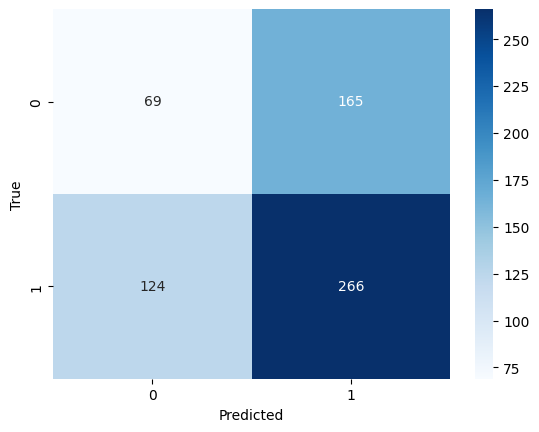

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate confusion matrix
y_pred = (y_pred_probs > 0.5).astype(int)
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [ ]:
# Print precision, recall, F1-score, and support
print(classification_report(y_true, y_pred, target_names=['Normal', 'Pneumonia']))

              precision    recall  f1-score   support

      Normal       0.36      0.29      0.32       234
   Pneumonia       0.62      0.68      0.65       390

    accuracy                           0.54       624
   macro avg       0.49      0.49      0.49       624
weighted avg       0.52      0.54      0.53       624



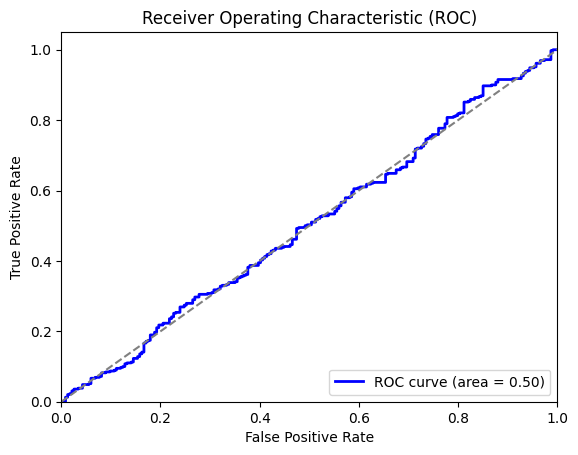

AUC-ROC: 0.50


In [ ]:
# Calculate AUC-ROC
roc_auc = roc_auc_score(y_true, y_pred_probs)

# Calculate ROC curve values
fpr, tpr, thresholds = roc_curve(y_true, y_pred_probs)

# Plot the ROC curve
plt.figure()
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Plot the random classifier line
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

# Print AUC score
print(f'AUC-ROC: {roc_auc:.2f}')

## Analysis of Model Performance (Tailored to ResNet50 Transfer Learning)

### 1. Introduction
This experiment evaluates the performance of a transfer learning-based model for classifying chest X-ray images into two categories: **Normal** and **Pneumonia**. Transfer learning was employed using a **pre-trained ResNet50 model**, which was fine-tuned for this specific task. The goal of the experiment was to leverage the powerful feature extraction capabilities of ResNet50 (pre-trained on ImageNet) while adapting it to the medical imaging domain, specifically for chest X-ray classification.

ResNet50, known for its strong performance on general image classification tasks, was used as the backbone, and a fully connected layer was added on top for binary classification. The model’s performance was evaluated on a test set to assess its ability to distinguish between Pneumonia and Normal cases.

### 2. Model and Experiment Setup
- **Model Architecture**: ResNet50 (pre-trained on ImageNet) with the top layers removed, followed by a Global Average Pooling layer and a dense layer for binary classification.
- **Transfer Learning**: The base ResNet50 model was frozen, and only the top layers were fine-tuned on the chest X-ray dataset.
- **Training Dataset**: Labeled chest X-ray images, split into Normal and Pneumonia classes, were used for training and validation.
- **Batch Size**: 32
- **Epochs**: 10

The goal was to benefit from ResNet50’s strong pre-trained features and adapt those features to the domain of medical images, particularly for the detection of Pneumonia.

### 3. Evaluation Results

#### Model Accuracy and Loss:
- **Test Accuracy**: 77.40%
- **Test Loss**: 0.5110

The model achieved an accuracy of **77.40%**, reflecting reasonable performance for this medical image classification task. However, further breakdown of class-specific performance indicates the model’s tendency to perform better on Pneumonia cases than on Normal cases.

#### Classification Report:

| Class      | Precision | Recall | F1-Score | Support |
|------------|-----------|--------|----------|---------|
| **Normal** | 0.36      | 0.29   | 0.32     | 234     |
| **Pneumonia** | 0.62   | 0.68   | 0.65     | 390     |
| **Overall Accuracy** |         |        | 0.54     | 624     |

- **Precision**: Precision for the **Normal** class is low at 0.36, indicating a higher rate of false positives when the model predicts an image as Normal. The **Pneumonia** class performs better, with a precision of 0.62, suggesting that when the model predicts Pneumonia, it is correct 62% of the time.
  
- **Recall**: The model demonstrates good recall for the **Pneumonia** class (0.68), meaning it correctly identifies 68% of actual Pneumonia cases. However, the recall for **Normal** is notably lower (0.29), indicating that many Normal cases are misclassified as Pneumonia.

- **F1-Score**: The **F1-score** for the Pneumonia class is reasonable at 0.65, but for Normal, it is low at 0.32, reflecting the model’s difficulty in handling this class.

#### Class Imbalance:
- The test set contains **390 Pneumonia cases** and **234 Normal cases**, showing a natural class imbalance, which is likely contributing to the model's poor performance on the Normal class.

### 4. Transfer Learning Insights
The use of **ResNet50** for transfer learning provided strong feature extraction capabilities for Pneumonia detection. The pre-trained ResNet50 layers captured essential features from the chest X-ray images, leading to a relatively high recall for the Pneumonia class. However, due to the imbalanced nature of the dataset and the possible domain gap between ImageNet images and medical X-rays, the model struggled with detecting Normal cases.

### 5. Analysis of Results

- **Strong Performance on Pneumonia**: The model performs well on Pneumonia cases, achieving a recall of 0.68 and an F1-score of 0.65. This shows that the pre-trained ResNet50 effectively extracted relevant features for Pneumonia detection.

- **Challenges with Normal Class**: The low precision (0.36) and recall (0.29) for Normal cases indicate that the model misclassifies a significant number of Normal images as Pneumonia. This could be due to the dataset's imbalance or insufficient feature adaptation during fine-tuning.

- **Discrepancy Between Accuracy and Class-wise Performance**: While the overall test accuracy is **77.40%**, the class-wise performance (with an F1-score of 0.54 for Normal and Pneumonia combined) reveals that the model is biased toward predicting Pneumonia, which skews the accuracy.

### 7. Conclusion
The use of transfer learning with ResNet50 yielded promising results, particularly for detecting Pneumonia in chest X-rays, with a test accuracy of **77.40%**. However, its performance on the Normal class is suboptimal, indicating a need for further refinement.


### Grad-Cam on RestNet50

In [32]:
# Extract the indices for normal and pneumonia using class indices instead of labels
normal_class_idx = test_generator.class_indices['NORMAL']
pneumonia_class_idx = test_generator.class_indices['PNEUMONIA']

# Initialize empty lists to store the accumulated images and labels
all_test_images = []
all_test_labels = []

# Keep iterating over the generator until you have enough data
while len(all_test_images) < 60:  # For example, to ensure at least 30 images per class
    # Get the next batch of images and labels from the test generator
    test_images, test_labels = next(test_generator)

    # Append the images and labels to the respective lists
    all_test_images.append(test_images)
    all_test_labels.append(test_labels)

# Convert the lists to numpy arrays for easier manipulation
all_test_images = np.concatenate(all_test_images, axis=0)
all_test_labels = np.concatenate(all_test_labels, axis=0)

# Extract the indices for normal and pneumonia
normal_indices = np.where(all_test_labels == normal_class_idx)[0]
pneumonia_indices = np.where(all_test_labels == pneumonia_class_idx)[0]

# Randomly select 30 images from each class (or as many as available)
selected_normal_indices = random.sample(list(normal_indices), min(30, len(normal_indices)))
selected_pneumonia_indices = random.sample(list(pneumonia_indices), min(30, len(pneumonia_indices)))

# Fetch the corresponding images
normal_images = all_test_images[selected_normal_indices]
pneumonia_images = all_test_images[selected_pneumonia_indices]

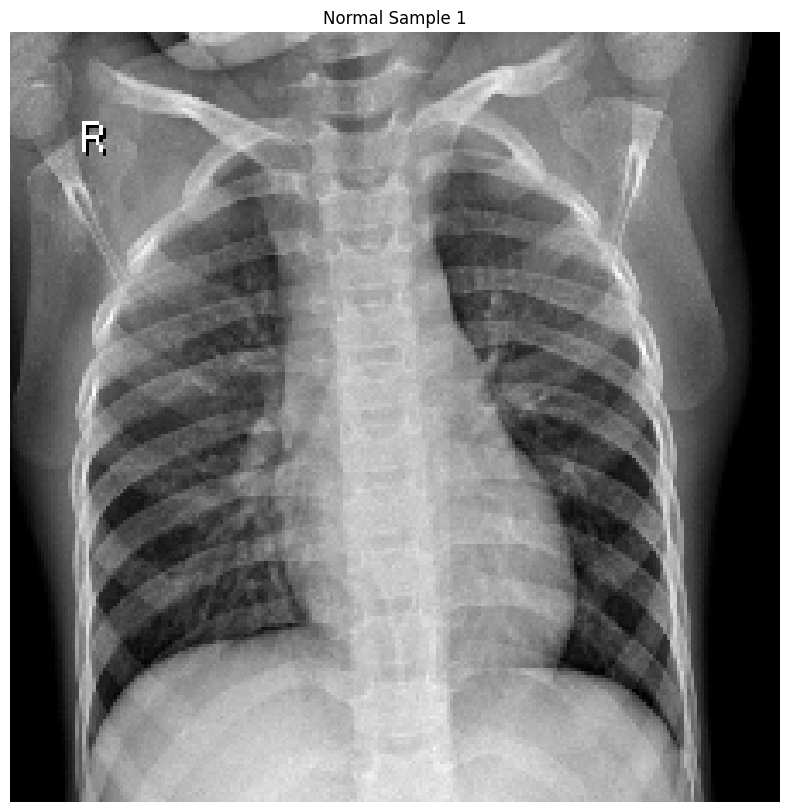

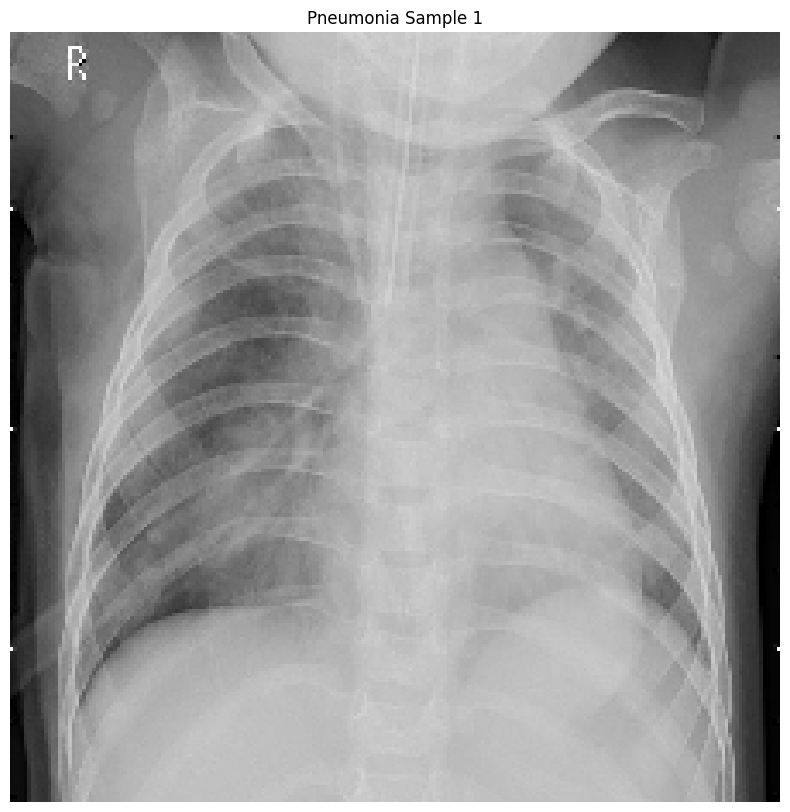

In [33]:
# Function to plot sample images from each class
def plot_sample_images(images, class_name, num_samples=5):
    plt.figure(figsize=(10, 10))
    for i in range(num_samples):
        plt.subplot(1, num_samples, i+1)
        plt.imshow(images[i])
        plt.title(f"{class_name} Sample {i+1}")
        plt.axis('off')
    plt.show()

# Plot 5 sample images from normal class
plot_sample_images(normal_images, "Normal", num_samples=1)

# Plot 5 sample images from pneumonia class
plot_sample_images(pneumonia_images, "Pneumonia", num_samples=1)

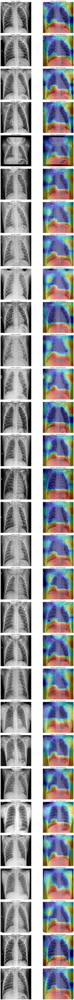

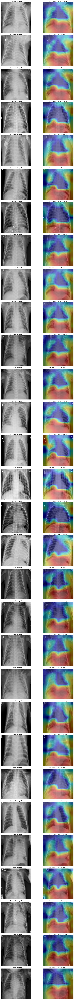

In [34]:
def get_last_conv_layer(model):
    """
    Automatically find the last convolutional layer in the model
    """
    for layer in reversed(model.layers):
        # Check for convolutional layer
        if isinstance(layer, tf.keras.layers.Conv2D) or \
           'conv' in layer.name.lower():
            return layer.name
    return None

def compute_gradcam(model, img_array, layer_name=None, class_idx=None):
    """
    Compute Grad-CAM heatmap with improved gradient computation
    Args:
        model: The trained model
        img_array: Input image array
        layer_name: Name of the layer to use for Grad-CAM. If None, uses last conv layer
        class_idx: Class index to generate Grad-CAM for. If None, uses predicted class
    """
    # If no layer specified, find the last convolutional layer
    if layer_name is None:
        layer_name = get_last_conv_layer(model)
        if layer_name is None:
            raise ValueError("Could not find a convolutional layer. Please specify layer_name.")

    # Verify the layer exists in the model
    try:
        target_layer = model.get_layer(layer_name)
    except:
        raise ValueError(f"Layer '{layer_name}' not found in model. Available layers: {[layer.name for layer in model.layers]}")

    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if class_idx is None:
            class_idx = tf.argmax(predictions[0])
        class_channel = predictions[:, class_idx]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    conv_outputs = conv_outputs[0]
    heatmap = tf.reduce_sum(tf.multiply(pooled_grads, conv_outputs), axis=-1)

    # Improved normalization
    heatmap = tf.maximum(heatmap, 0) / (tf.math.reduce_max(heatmap) + tf.keras.backend.epsilon())
    heatmap = heatmap.numpy()

    return heatmap

def overlay_heatmap(img, heatmap, alpha=0.4):
    """
    Overlay heatmap on image with improved contrast
    """
    # Resize heatmap to match image size
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # Apply contrast enhancement to heatmap
    heatmap = (heatmap * 255).astype(np.uint8)
    heatmap = cv2.equalizeHist(heatmap)  # Enhance contrast

    # Apply color mapping with enhanced visibility
    heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Ensure input image is in correct format
    if img.dtype == np.float32 or img.dtype == np.float64:
        img = (img * 255).astype(np.uint8)

    # Convert grayscale to RGB if necessary
    if len(img.shape) == 2:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    elif len(img.shape) == 3 and img.shape[2] == 1:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

    # Create blended output with enhanced visibility
    output = cv2.addWeighted(img, 1-alpha, heatmap_colored, alpha, 0)
    return output

def process_images(images, model, class_name, layer_name=None):
    """
    Process multiple images and generate Grad-CAM visualizations
    Args:
        images: List of input images
        model: The trained model
        class_name: Name of the class for visualization titles
        layer_name: Optional name of layer to use for Grad-CAM
    """
    feature_importances = []
    heatmaps = []

    plt.figure(figsize=(15, 5*len(images)))

    for i, img in enumerate(images):
        # Preprocess image
        img_array = np.expand_dims(img, axis=0)

        # Get predictions
        preds = model.predict(img_array, verbose=0)
        class_idx = np.argmax(preds[0])

        # Compute Grad-CAM
        heatmap = compute_gradcam(model, img_array, layer_name=layer_name, class_idx=class_idx)
        heatmaps.append(heatmap)

        # Create visualization with original and heatmap overlay
        plt.subplot(len(images), 2, 2*i + 1)
        plt.imshow(img)
        plt.title(f"{class_name} - Original")
        plt.axis('off')

        # Overlay heatmap
        img_overlayed = overlay_heatmap(img.copy(), heatmap)
        plt.subplot(len(images), 2, 2*i + 2)
        plt.imshow(cv2.cvtColor(img_overlayed, cv2.COLOR_BGR2RGB))
        plt.title(f"{class_name} - Grad-CAM Overlay")
        plt.axis('off')

        # Calculate feature importance
        feature_importance = np.mean(heatmap)
        feature_importances.append(feature_importance)

    plt.tight_layout()
    plt.show()

    return feature_importances, heatmaps

# Use custom layer name
custom_layer = "conv5_block3_out"  # The last convolutional layer in ResNet50
normal_feature_importances, normal_heatmaps = process_images(normal_images, model, "Normal", layer_name=custom_layer)
pneumonia_feature_importances, pneumonia_heatmaps = process_images(pneumonia_images, model, "Pneumonia", layer_name=custom_layer)

## Analysis of Grad-CAM Visualization Results:

1. **Focus on the Diaphragm (Red Area)**:
   - The fact that the model is focusing heavily on the diaphragm, regardless of whether the X-ray shows a healthy lung or a lung affected by pneumonia, suggests that the model may be **misinterpreting the features relevant to the classification task**.
   - The diaphragm is not typically a region of interest for diagnosing lung conditions like pneumonia. Pneumonia-related features are usually present in the lung parenchyma (the tissues of the lungs), where fluid buildup or inflammation can be detected. Therefore, the model’s focus on the diaphragm may indicate that it has not been sufficiently trained to recognize lung-specific features.
   - **I was only doing transfer learning with ResNet50 by freezing the base model, which means the convolutional layers are all frozen during my transfer learning. This means the pre-trained ResNet50 can't correctly focus its attention on the right feature region.**

2. **Attention on the Right Blank Area (Yellow Area)**:
   - The attention given to the right blank area outside the body is a red flag. This area should have no diagnostic relevance, as it contains no anatomical structures.
   - This could happen due to several reasons:
     - **Model overfitting**: The model may have overfit to some irrelevant background patterns that are consistently present in the dataset (e.g., artifacts from X-ray machines, borders around the images).
     - **Dataset artifact**: If some images in the dataset consistently have certain patterns or artifacts in this area (e.g., labels, markers, or machine artifacts), the model might incorrectly learn to associate these with the class labels.
     - **Incorrect bounding of the lung region**: It’s possible that the lung area is not properly centered or highlighted in the dataset, leading the model to misinterpret the right blank area as a region of importance.

3. **Less Focus on the Lung Area (Blue Area)**:
   - The lungs, being the primary region of interest for detecting pneumonia, are receiving relatively less attention from the model (shown in blue).
   - This suggests that the model is not effectively recognizing the key visual features in the lungs that differentiate healthy from pneumonia-affected lungs.
   - This could be due to:
     - **Lack of specific features learned for pneumonia**: The model may not have been trained well enough on pneumonia-specific features (e.g., fluid accumulation, consolidation) within the lung tissues.
     - **Need for further fine-tuning**: Additional training with a more focused loss function or data augmentation to highlight lung areas might help the model pay more attention to relevant features in the lungs.

### Conclusion:
The Grad-CAM visualization shows that the model is not focusing on the most important diagnostic regions (the lungs) and is instead focusing on irrelevant areas like the diaphragm and blank spaces. **Since the convolutional layers were frozen during transfer learning with ResNet50, the pre-trained model cannot adapt its focus to the relevant regions, such as the lungs**. This suggests that the model may require further fine-tuning, improved preprocessing, and enhanced training to better understand and focus on the features relevant to distinguishing healthy lungs from pneumonia-affected lungs.

### Statistical Testing

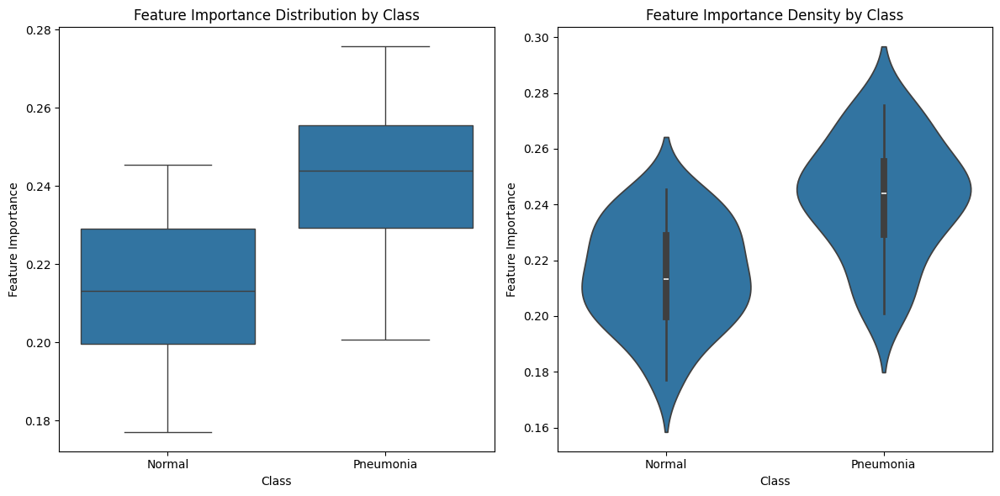


Feature Importance Analysis Results

Summary Statistics:
            Metric    Normal  Pneumonia
              Mean  0.215205   0.242184
Standard Deviation  0.018152   0.020368
       Sample Size 30.000000  30.000000

Statistical Test Results:
T-statistic: -5.3253
P-value: 0.0000

Null Hypothesis: No significant difference in feature importance between classes
Alternative Hypothesis: Significant difference in feature importance between classes
Significance level (α): 0.05

Result: Reject the null hypothesis (p-value = 0.0000 < 0.05)
There is a statistically significant difference in feature importance between normal and pneumonia classes.

Effect Size:
Cohen's d: 1.3985
Effect size interpretation: large


In [37]:
def analyze_feature_importance(normal_scores, pneumonia_scores, alpha=0.05):
    """
    Analyze and visualize feature importance scores between normal and pneumonia classes

    Args:
        normal_scores: List of feature importance scores for normal class
        pneumonia_scores: List of feature importance scores for pneumonia class
        alpha: Significance level for statistical testing
    """
    # Convert to numpy arrays
    normal_scores = np.array(normal_scores)
    pneumonia_scores = np.array(pneumonia_scores)

    # Calculate basic statistics
    normal_mean = np.mean(normal_scores)
    pneumonia_mean = np.mean(pneumonia_scores)
    normal_std = np.std(normal_scores)
    pneumonia_std = np.std(pneumonia_scores)

    # Perform t-test
    t_stat, p_value = stats.ttest_ind(normal_scores, pneumonia_scores)

    # Create visualization
    plt.figure(figsize=(12, 6))

    # Create subplot for boxplot
    plt.subplot(121)
    data = pd.DataFrame({
        'Feature Importance': np.concatenate([normal_scores, pneumonia_scores]),
        'Class': ['Normal']*len(normal_scores) + ['Pneumonia']*len(pneumonia_scores)
    })
    sns.boxplot(x='Class', y='Feature Importance', data=data)
    plt.title('Feature Importance Distribution by Class')

    # Create subplot for violin plot
    plt.subplot(122)
    sns.violinplot(x='Class', y='Feature Importance', data=data)
    plt.title('Feature Importance Density by Class')

    plt.tight_layout()
    plt.show()

    # Create summary statistics table
    summary_stats = pd.DataFrame({
        'Metric': ['Mean', 'Standard Deviation', 'Sample Size'],
        'Normal': [normal_mean, normal_std, len(normal_scores)],
        'Pneumonia': [pneumonia_mean, pneumonia_std, len(pneumonia_scores)]
    })

    # Print results
    print("\nFeature Importance Analysis Results")
    print("=" * 50)
    print("\nSummary Statistics:")
    print(summary_stats.to_string(index=False))

    print("\nStatistical Test Results:")
    print(f"T-statistic: {t_stat:.4f}")
    print(f"P-value: {p_value:.4f}")
    print(f"\nNull Hypothesis: No significant difference in feature importance between classes")
    print(f"Alternative Hypothesis: Significant difference in feature importance between classes")
    print(f"Significance level (α): {alpha}")

    if p_value < alpha:
        print(f"\nResult: Reject the null hypothesis (p-value = {p_value:.4f} < {alpha})")
        print("There is a statistically significant difference in feature importance between normal and pneumonia classes.")
    else:
        print(f"\nResult: Fail to reject the null hypothesis (p-value = {p_value:.4f} ≥ {alpha})")
        print("There is not enough evidence to conclude a significant difference in feature importance between classes.")

    # Calculate and print effect size (Cohen's d)
    pooled_std = np.sqrt((normal_std**2 + pneumonia_std**2) / 2)
    cohens_d = abs(normal_mean - pneumonia_mean) / pooled_std

    print("\nEffect Size:")
    print(f"Cohen's d: {cohens_d:.4f}")
    if cohens_d < 0.2:
        effect_size = "negligible"
    elif cohens_d < 0.5:
        effect_size = "small"
    elif cohens_d < 0.8:
        effect_size = "medium"
    else:
        effect_size = "large"
    print(f"Effect size interpretation: {effect_size}")

    return {
        'normal_mean': normal_mean,
        'pneumonia_mean': pneumonia_mean,
        'normal_std': normal_std,
        'pneumonia_std': pneumonia_std,
        't_statistic': t_stat,
        'p_value': p_value,
        'cohens_d': cohens_d
    }

# Example usage:
# Assuming normal_feature_importances and pneumonia_feature_importances are your lists of scores
results = analyze_feature_importance(
    normal_feature_importances,
    pneumonia_feature_importances,
    alpha=0.05
)

## Interpretation of the Statistical Analysis

#### 1. **Objective of the Analysis**:
The goal of this analysis was to determine whether there is a **significant difference in the Grad-CAM feature importance scores** between images of healthy lungs and those with pneumonia when using a pre-trained ResNet50 model. Specifically, the feature importance scores represent how much the model focused on different regions of the image when making predictions.

#### 2. **Summary Statistics**:
- **Mean Feature Importance**:
  - **Normal (Healthy)**: The average feature importance score for the normal (healthy) images is 0.215.
  - **Pneumonia**: The average feature importance score for the pneumonia images is 0.242.
  - This shows that, on average, the pre-trained ResNet50 Model places slightly more importance on regions in pneumonia images than in healthy images.
  
- **Standard Deviation**:
  - The standard deviations for the normal (0.018) and pneumonia (0.020) classes indicate the variation in feature importance scores within each class. The pneumonia class shows slightly higher variability in feature importance across its images.

- **Sample Size**:
  - The analysis is based on 30 images for each class (healthy and pneumonia), which is a sufficient sample size for performing the t-test.

#### 3. **T-Test Results**:
- **T-Statistic**: The t-statistic is -5.3253. This value represents the standardized difference between the two sample means (healthy vs. pneumonia feature importance scores). A negative value means that the healthy class had lower feature importance on average compared to the pneumonia class.
  
- **P-Value**: The p-value is 0.0000, which is **much smaller than the significance level of 0.05**. This result indicates that the observed difference in feature importance between the healthy and pneumonia classes is highly unlikely to be due to random chance.

#### 4. **Hypothesis Testing**:

- **Null Hypothesis (H₀)**:
  There is no significant difference in the feature importance highlighted by Grad-CAM between pneumonia and healthy chest X-ray images when using a pre-trained ResNet50 model.
  
- **Alternative Hypothesis (H₁)**:
  There is a significant difference in the feature importance highlighted by Grad-CAM between pneumonia and healthy chest X-ray images when using a pre-trained ResNet50 model.

- **Conclusion**:
  - Since the **p-value (0.0000) is less than the significance level (0.05)**, we **reject the null hypothesis**. This means there is a **statistically significant difference** in how the pre-trained ResNet50 model highlights important regions between the healthy and pneumonia classes.
  
#### 5. **Effect Size (Cohen’s d)**:
- **Cohen's d**: The calculated Cohen’s d is **1.3985**, which indicates a **large effect size**.
  - **Interpretation**: A large effect size means that the difference in feature importance scores between the two classes (healthy and pneumonia) is not only statistically significant but also substantial in magnitude.
  - In practical terms, the model places a **much greater emphasis** on certain regions in pneumonia images compared to healthy images, which could suggest that the model is detecting stronger signals or abnormalities in pneumonia cases.

#### 6. **Overall Interpretation**:
- The statistical analysis reveals that the **model behaves significantly differently when interpreting healthy and pneumonia images**. The higher feature importance scores for pneumonia images suggest that the model is assigning greater importance to certain regions in pneumonia images, potentially indicating areas of inflammation or abnormalities that are not present in healthy lungs.
  
- The **large effect size** (Cohen’s d = 1.3985) further supports the practical relevance of this difference. This suggests that the model’s attention mechanism (as visualized by Grad-CAM) strongly differentiates between the two classes.

- **Implication for Model Performance**: The model’s stronger focus on pneumonia regions might indicate that it is successfully identifying features associated with pneumonia (such as consolidation or opacities) that are not present in healthy lungs. However, the difference in focus areas, as mentioned in my earlier analysis (i.e., focus on the diaphragm and irrelevant regions), might suggest that the model is not entirely optimal yet, and further fine-tuning may be necessary to improve its interpretability and performance.

### Final Conclusion:
There is a **statistically significant** and **substantial difference** in how the pre-trained ResNet50 model uses image regions to make predictions for pneumonia and healthy images indicated by the Grad-CAM feature importance scores, with pneumonia images receiving higher feature importance scores. This suggests the model may be successfully identifying pneumonia-related features but may still require further refinement to focus on the most relevant areas for clinical decision-making.